In [107]:
from sage.stats.distributions.discrete_gaussian_integer import DiscreteGaussianDistributionIntegerSampler

import time
import numpy as np
import itertools
from multiprocessing import cpu_count
from datetime import datetime

In [108]:
"""mK     : conductor
   d      : degree of cyclotomicField
   zmstar : list of number co-prime with mK
   K      : cyclotomicField 
"""

ncpus=cpu_count()

params = {  512: {'mK': 1024, 'thr': 2.04, 'q': 12289},
            648: {'mK': 1944, 'thr': 2.13, 'q': 3889 },
            768: {'mK': 2304, 'thr': 2.20, 'q': 18433},
            864: {'mK': 2592, 'thr': 2.25, 'q': 10369},
            972: {'mK': 2916, 'thr': 2.30, 'q': 17497},
           1024: {'mK': 2048, 'thr': 2.33, 'q': 12289} }

## Conjugate of $f\in\mathcal{K}$
$f^*\in \mathcal{K}$ is conjugate of $f\in \mathcal{K}$ if $f^*(\zeta)=f(\bar{\zeta})$ where $\mathcal{K}=\mathbb{Q}(\zeta)$.
## Scalar product in $\mathcal{K}^2$
Given $x=(x_1,x_2), y=(y_1,y_2)\in \mathcal{K}^2$ then 
$
\langle x,y\rangle_{\mathcal{K}}=x_1^* y_1+x_2^*y_2.
$

In [109]:
param = params[512]
mK  = param['mK']
thr0= param['thr']
q   = param['q']

d = euler_phi(mK)
K.<z> = CyclotomicField(mK) # WARNING: degree(K) = d

def conj(f):
    coeffs = f.list()
    new_coeffs = []
    t = mK-2
    for c in coeffs:
        new_coeffs.append(c)
        new_coeffs += [0]*t
    
    return K(new_coeffs)

def Prod(x,y):
    return conj(x[0])*y[0] + conj(x[1])*y[1]


## Hybrid Gaussian sampler
**Input:** Center $c\in \mathcal{K}_{\mathbb{R}}^2$, secret base $B=[b_1, b_2]$ st $\mathcal{L}=\phi(B\mathcal{R}^2)$and its GSO base $\tilde{B}=[\tilde{b_1},\tilde{b_2}]$, parameter $\sigma>0$

**Output:** $z$ follows $D_{\mathcal{L},c,\sigma^2 I_{2d}}$

<span style='color:red'> ***Precomputed:*** </span> $\sigma_i := \sqrt{\frac{\sigma^2}{\langle \tilde{b_i},\tilde{b_i} \rangle}-r^2}\in\mathcal{K}_\mathbb{R}^{++};\quad\beta_i=\langle \tilde{b_i},\tilde{b_i}\rangle^{-1}$

<span style='color:blue'> Note: </span> 
* This square root is pre-computed by **DFT**. 
* In the following implementation:
 * **Sage**'s implemented polynomial multiplication is used instead of **DFT**. This multiplication is imported from [**Flint**](https://flintlib.org/doc/fmpz_poly.html) in which it is said to be optimized.
 * **Sage**'s implemented Discrete Gaussian distribution over $\mathbb{Z}$ is used for sampling.
 * **Sage**'s implementation is slower than **DFT** and it crashes with big dimension.

In [123]:
r = 1
T = RealDistribution('gaussian', 1)
#D = DiscreteGaussianDistributionIntegerSampler(sigma = r)
b1 = [K.random_element(), K.random_element()]
b2 = [K.random_element(), K.random_element()]
B = [b1, b2]

#base GSO
t = Prod(b1,b2)*(Prod(b1,b1).inverse_of_unit())
b1_ = b1
b2_ = [(b2[i] - t*b1[i]) for i in range(2)]
B_GSO = [b1_, b2_]

#Precompute
_sigma = 0.5
pre_sigma = K([_sigma]*d)
beta = [Prod(b1_,b1_).inverse_of_unit(), Prod(b2_,b2_).inverse_of_unit()]
sigma = 1

def DiscreteGaussian(f, r):
    coeffs = f.list()
    l = []
    for c in coeffs:
        D = DiscreteGaussianDistributionIntegerSampler(c = c, sigma = r)
        l.append(D())
    
    return K(l)

def Hybrid(B, B_GSO, c, sigma, beta):
    c2 = c; v2 = 0
    d2 = Prod(B_GSO[1], c2)*beta[1]
    u2 = K([T.get_random_element() for _ in range(d)])
    y2 = sigma[1]*u2
    #x2 = K([D() for _ in range(d)]) + (d2 - y2)
    x2 = DiscreteGaussian(d2-y2, r)
    
    #c1 = c2 - x2*B[1]; v1 = x2*B[0]
    c1 = [c2[i] - x2*B[1][i] for i in range(2)]; v1 = [x2*B[0][i] for i in range(2)]
    d1 = Prod(B_GSO[0], c1)*beta[0]
    u1 = K([T.get_random_element() for _ in range(d)])
    y1 = sigma[0]*u1
    #x1 = K([D() for _ in range(d)]) + (d1 - y1)
    x1 = DiscreteGaussian(d1-y1, r)
    
    #v0 = v1 + x1*B[0]
    v0 = [v1[i] + x1*B[0][i] for i in range(2)]
    
    return v0
    

In [125]:
B, B_GSO

([[3*z, -z - 1], [-z + 1, 1]],
 [[3*z, -z - 1], [1/11*z + 5/11, -6/11*z + 9/11]])

In [126]:
sigma = [K.random_element(), K.random_element()]
c = [K.random_element(), K.random_element()]
c, sigma

([z + 2, 5*z - 1], [1, z - 2])

In [127]:
Hybrid(B, B_GSO, c, sigma, beta)

[-3*z - 27, -8*z + 10]

In [112]:
b1 = [K.random_element(), K.random_element()]
b2 = [K.random_element(), K.random_element()]
B = [b1, b2]; B

[[z^511 + 3*z^510 + 1/2*z^508 - z^507 - z^506 - 3/8*z^504 + 2*z^503 + 1/2*z^502 - 2*z^501 + 1/2*z^500 + 1/14*z^498 + z^497 - z^496 - 1/10*z^495 + 5/3*z^494 + 5/12*z^493 - 3/8*z^491 - 125*z^490 - 2*z^488 - 1/2*z^487 - z^485 - z^484 - 5/2*z^483 + 3/28*z^481 + 1/2*z^479 + 2/17*z^478 + 1/5*z^477 - 3*z^476 + 17*z^474 - 1/22*z^473 - 2*z^472 - 1/6*z^471 - 4*z^470 - 20*z^469 - 1/2*z^468 - 1/2*z^467 + 23*z^466 - 6/29*z^464 + z^463 + 1/4*z^462 + z^461 + 1/13*z^460 - 7*z^459 - z^458 + 4/11*z^456 + 2*z^455 - 5*z^454 - 1/3*z^452 + 1/2*z^451 + 1/2*z^450 - 2*z^448 - 1/18*z^445 - 2/5*z^444 - 2*z^443 - 1/8*z^442 - 1/5*z^441 + 3/14*z^440 - 6*z^439 + 5*z^438 + 8*z^437 - 1/6*z^436 + 1/3*z^435 - 1/3*z^434 - 6*z^432 - 4*z^431 - 10/7*z^430 + 3*z^428 - 1/2*z^427 - z^426 - 124/3*z^424 + z^423 - 1/2*z^422 + 4*z^421 + 1/2*z^420 + 6*z^418 - 11/2*z^417 - 1/20*z^416 - 1/53*z^415 - 1/2*z^414 + z^413 + 1/3*z^412 + z^411 + z^410 + 10/3*z^408 - 11/2*z^407 - 1/3*z^406 + z^405 + z^404 + z^403 + z^402 - 1/2*z^401 - 4*z^40

In [120]:
p = K.random_element(); p

10*z^510 + z^509 + 1/2*z^508 + z^507 + 2*z^505 + 75*z^504 + 7/2*z^503 + 1/3*z^500 + 2*z^498 - 7/4*z^495 - 1/3*z^494 + 1/2*z^493 + z^491 + z^490 + 1/18*z^489 - 1/3*z^488 + 1/104*z^485 + 1/2*z^484 - z^481 + 6*z^479 - 2*z^478 - z^477 + z^476 + 7*z^475 + 1/2*z^474 - 1/2*z^473 - 17/5*z^470 + z^469 + 1/3*z^468 + 3/22*z^467 + 1/3*z^466 - 4*z^464 + z^463 + 1/11*z^462 + 8*z^461 + 2/3*z^460 + 4*z^459 - 13*z^457 + 18*z^456 - 2*z^455 - 2*z^453 + 4/3*z^452 - z^451 - 2/137*z^450 - 2*z^448 - 2*z^447 + 3/10*z^446 + 4/5*z^445 + 1/4*z^444 + 2*z^443 + 2*z^442 - z^439 - 3/2*z^437 - 7*z^436 + 1/10*z^434 - z^433 + 1/4*z^432 - 35*z^430 - 9/31*z^429 - z^428 - 7*z^426 - 1/2*z^425 - z^424 - z^423 + 22*z^422 - 1/2*z^421 + 1/4*z^420 - z^418 + 9/7*z^416 - 3/2*z^415 - 1/7*z^413 - 7*z^412 - 150*z^411 - 1/2*z^410 - 6*z^409 - 1/5*z^407 + z^406 - z^405 + z^404 - 1/2*z^403 + z^402 - 7/13*z^401 - 1/3*z^400 - 1/2*z^399 + 2/3*z^398 + z^397 + 1/2*z^396 - 11*z^395 + 1/3*z^394 + 1/2*z^393 - 1/7*z^392 + 1/2*z^391 + 3*z^390 + z

In [121]:
~p

-594970316764761932300038975504808670686832142771587810511783919484266104551292131463720843972059596811897821438042992420302681867005925306605100671739220484997192233215459548166873960210755465353804565870228066855673766460247904502742809782164523078172315455797547364132507968605827221112662979589833518774582216521475434992668692366340470807491398517059419827679614089979242462612557184810261549730210834268133200780623629898349535966800446808143530543962173560787321481217467043255414999376672671878569034721918972695397712573050729085779874770047849037095247400935176438524269400773738002906466699948250787167716103315557164372593003743903456107125800299126822577549480204454670259628232329010238908656294323880003505842633847904006204116950044923850710130308822138788087437984877307860863069545584729232077803131560108732227943230130665654081617899499804849842380960186211984895511614196527662568211042559432009669058875293152838051582625089547593712577126608805729128783259486545647346096125863

In [115]:
p = Prod(b1,b1); p

55816256995711407817502539369/3610739863185212034950400*z^511 + 2505077578288055385059939918833/695067423663153316727952000*z^510 + 149073669857948362973049657227/46337828244210221115196800*z^509 + 794654362823129326753355920603/1042601135494729975091928000*z^508 - 1219364351375701975794162053/4964767311879666548056800*z^507 - 4657208197251636829136574598747/5352019162206280538805230400*z^506 - 284349005009318222618720561/1362877301300300621035200*z^505 - 3604950792984897863495216021/2106264920191373687054400*z^504 - 3973127351635096518002948363/29788603871277999288340800*z^503 - 2315270219400642773606173769/6036111837074752487374320*z^502 - 10907399384054428551060647473/44589230951975873148585600*z^501 + 13096653193731626324248330999/2044315951950450931552800*z^500 + 29653989803646227152345265863/23168914122105110557598400*z^499 - 468612036417108942562445229953/23168914122105110557598400*z^498 - 28197007250563942272546298511/169311295507691192536296000*z^497 + 303724214263548604458760

In [116]:
inv_p = p.inverse_of_unit()

In [117]:
inv_p

-858695016492755506065112588090862505996088705410069062565746254608647464279708162952586277133454146286634410170167142918587753776903514370568415149441155075879318686721705910385898484448924986482523439745692908964086037904041076823455717575076922132126976580689988725704589700409497947218280058966923723899290640618951851484831145191199618430790107909376937009456653825806896002382512122445868948422764542453342059665728188920442248693067007983508850842438659910579956693046097188822741711531549386292999517641561161802496257771321363098940762007762815311167129675534327492465203264660341090809578501974066431353166383863163003992159811779871500811002107803212258860730599602213826251003970168878248214563516538821582915946660634486164227180398383269634654456115766854385626747412811862807339145740397416080497771708273252972565368554680951730477762273737615753097867636883445042369731065620915057065697497274945244391411277043961935497504446557195049184902374914979474315149549477518057564200481672

In [113]:
t = Prod(b1,b2)*(Prod(b1,b1).inverse_of_unit())

KeyboardInterrupt: 

In [102]:
B_GSO

[[7*z, 15*z - 36], [-405/314*z + 4773/1570, -651/1570*z - 133/314]]

In [105]:
sigma = [z+1,z]
c = [K.random_element(), K.random_element()]; c

[-z + 1, -z - 2]

In [106]:
Hybrid(B, B_GSO, c, sigma, beta)

[14*z + 7, 66*z - 57]

## Drafts

In [122]:
mK=4
K.<z> = CyclotomicField(mK)
d = euler_phi(mK)
f = z +1

def conj(f):
    coeffs = f.list()
    new_coeffs = []
    for c in coeffs:
        new_coeffs.append(c)
        new_coeffs += [0]*(mK-2)        #no need for that much 0
    return K(new_coeffs)

In [81]:
K([0.5]*d)

1/2*z + 1/2

In [83]:
f = K.random_element()
sqrt(f)

sqrt(I + 2)

In [57]:
conj(f)

-z + 1

In [58]:
conj

<function conj at 0x182fec670>

In [64]:
b1 = [K.random_element(), K.random_element()]
b2 = [K.random_element(), K.random_element()]
b1, b2

([z + 4, z - 2], [25*z + 1, -2])

In [60]:
conj(b1[0]), conj(g)

-2*z

In [66]:
Prod(b1,b2)

101*z + 33

In [67]:
Prod(b1,b2).inverse_of_unit()

-101/11290*z + 33/11290

In [72]:
t = Prod(b1,b2)*(Prod(b1,b1).inverse_of_unit())

In [76]:
b2_ = [(b2[i] - t*b1[i]) for i in range(2)]

In [77]:
Prod(b1, b2_)

0

In [50]:
f.inverse_of_unit()

-1/2*z + 1/2

In [ ]:
K([1,2,3,4,5])

In [10]:
K([1,2])

2*z + 1

In [28]:
f.list()

[1, 1]

In [33]:
t=sqrt(z^2+1)

In [34]:
type(t)

<class 'sage.symbolic.expression.Expression'>

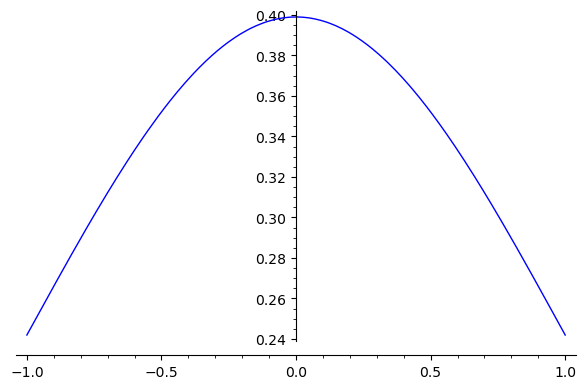

In [18]:
import matplotlib.pyplot as plt

sigma = 1
T = RealDistribution('gaussian', sigma)
T.plot()

In [16]:
S = []
N_exp = 1000

for _ in range(N_exp):
    S.append(T.get_random_element())


In [26]:
T.get_random_element()

-1.105894431674885

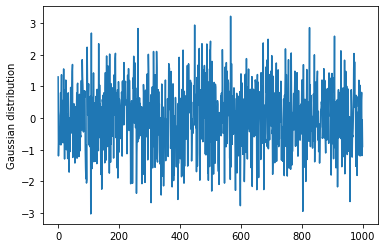

In [17]:
plt.plot(S)
plt.ylabel('Gaussian distribution')
plt.show()

In [22]:
K([i+1 for i in range(3)])

3*z^2 + 2*z + 1

In [25]:
K([1.2,2])

2*z + 6/5

In [27]:
K([T.get_random_element() for _ in range(3)])

112615062/77767187*z^2 + 187666602/270370369*z + 105889297/141004931